In [1]:
import os
import re
import sys
from pathlib import Path

import h5py
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
import skimage
from skimage import io
from tqdm.notebook import tqdm, trange

sc.settings.verbosity = 3

import matplotlib
from matplotlib import cm, colors
from matplotlib.pyplot import rc_context

sc.set_figure_params(format="png")
import anndata as ad
import seaborn as sns
from PIL import Image
from scipy import ndimage
from skimage import exposure, measure, morphology
from sklearn.cluster import MiniBatchKMeans
import math
import cv2
from matplotlib.ticker import (AutoMinorLocator, MultipleLocator)


In [2]:
p_dir = (Path().cwd().parents[0]).absolute()
data_dir = p_dir / "data"

In [3]:
%load_ext autoreload
%autoreload 2

module_path = str(p_dir / "src")

if module_path not in sys.path:
    sys.path.append(module_path)

import utils as my_utils

In [4]:
donors = [
    "LN Donor A",
    "LN Donor E",
    "INT Donor B",
    "INT Donor E",
    "TS Donor A",
    "TS Donor E",
]


# Read info

In [5]:
# Read mask image
def get_masks(mask_folder):
    """
    Function to get all mask from mask forlder
    """
    # Read masks
    masks = {}

    for (dirpath, dirnames, filenames) in os.walk(mask_folder):
        for name in sorted(filenames):
            if "tif" in name:
                filename = os.path.join(dirpath, name)
                img = skimage.io.imread(filename)
                condition =  name.split(".")[0]
                masks[condition] = img
            else:
                continue
    return masks


In [6]:
# Read single-cell data
adata_path = data_dir / "metadata" / f"combined_semi_final.h5ad"
adata = sc.read_h5ad(adata_path)

# Get follicle masks
masks_follicle = get_masks(data_dir / 'masks_follicle')


In [7]:
def circular_hist(ax, x, bins=16, density=True, offset=0, gaps=True):
    """
    Produce a circular histogram of angles on ax.

    Parameters
    ----------
    ax : matplotlib.axes._subplots.PolarAxesSubplot
        axis instance created with subplot_kw=dict(projection='polar').

    x : array
        Angles to plot, expected in units of radians.

    bins : int, optional
        Defines the number of equal-width bins in the range. The default is 16.

    density : bool, optional
        If True plot frequency proportional to area. If False plot frequency
        proportional to radius. The default is True.

    offset : float, optional
        Sets the offset for the location of the 0 direction in units of
        radians. The default is 0.

    gaps : bool, optional
        Whether to allow gaps between bins. When gaps = False the bins are
        forced to partition the entire [-pi, pi] range. The default is True.

    Returns
    -------
    n : array or list of arrays
        The number of values in each bin.

    bins : array
        The edges of the bins.

    patches : `.BarContainer` or list of a single `.Polygon`
        Container of individual artists used to create the histogram
        or list of such containers if there are multiple input datasets.
    """
    # Wrap angles to [-pi, pi)
    x = (x+np.pi) % (2*np.pi) - np.pi

    # Force bins to partition entire circle
    if not gaps:
        bins = np.linspace(-np.pi, np.pi, num=bins+1)

    # Bin data and record counts
    n, bins = np.histogram(x, bins=bins)

    # Compute width of each bin
    widths = np.diff(bins)

    # By default plot frequency proportional to area
    if density:
        # Area to assign each bin
        area = n / x.size
        # Calculate corresponding bin radius
        radius = (area/np.pi) ** .5
    # Otherwise plot frequency proportional to radius
    else:
        radius = n

    # Plot data on ax
    patches = ax.bar(bins[:-1], radius, zorder=1, align='edge', width=widths,
                     edgecolor='r', fill=True, color = 'r', alpha=0.8, linewidth=1)

    # Set the direction of the zero angle
    ax.set_theta_offset(offset)

    # Remove ylabels for area plots (they are mostly obstructive)
    if density:
        ax.set_yticks([])

    return n, bins, patches

[]

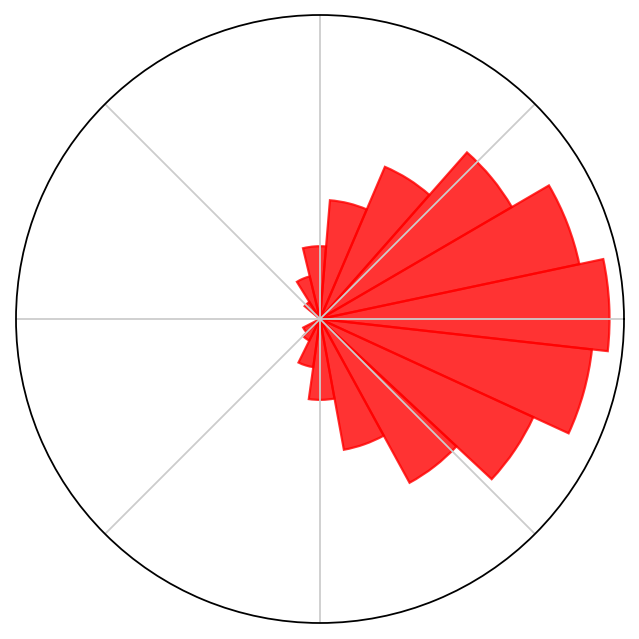

In [8]:
import matplotlib.pyplot as plt
import numpy as np

angles0 = np.random.normal(loc=0, scale=0.7, size=10000)

# Construct figure and axis to plot on
fig, ax = plt.subplots(figsize=(5,5), subplot_kw=dict(projection='polar'))

# Visualise by area of bins
circular_hist(ax, angles0)

ax.set_xticklabels([])
ax.set_yticklabels([])

# Compare follicle cell composition

In [9]:
from collections import defaultdict 
import matplotlib.pyplot as plt
from matplotlib.transforms import Affine2D, offset_copy

def rainbow_text(x, y, strings, colors, orientation='horizontal',
                 ax=None, **kwargs):
    """
    Take a list of *strings* and *colors* and place them next to each
    other, with text strings[i] being shown in colors[i].

    Parameters
    ----------
    x, y : float
        Text position in data coordinates.
    strings : list of str
        The strings to draw.
    colors : list of color
        The colors to use.
    orientation : {'horizontal', 'vertical'}
    ax : Axes, optional
        The Axes to draw into. If None, the current axes will be used.
    **kwargs
        All other keyword arguments are passed to plt.text(), so you can
        set the font size, family, etc.
    """
    if ax is None:
        ax = plt.gca()
    t = ax.transAxes
    fig = ax.figure
    canvas = fig.canvas

    assert orientation in ['horizontal', 'vertical']
    if orientation == 'vertical':
        kwargs.update(rotation=90, verticalalignment='bottom')

    for s, c in zip(strings, colors):
        text = ax.text(x, y, s + " ", color=c, transform=t, **kwargs)

        # Need to draw to update the text position.
        text.draw(canvas.get_renderer())
        ex = text.get_window_extent()
        # Convert window extent from pixels to inches
        # to avoid issues displaying at different dpi
        ex = fig.dpi_scale_trans.inverted().transform_bbox(ex)

        if orientation == 'horizontal':
            t = text.get_transform() + \
                offset_copy(Affine2D(), fig=fig, x=ex.width, y=0)
        else:
            t = text.get_transform() + \
                offset_copy(Affine2D(), fig=fig, x=0, y=ex.height)
            
def contrast_streching(img):
    p2, p98 = np.percentile(img, (0.5, 99.5))
    img = exposure.rescale_intensity(img, in_range=(p2, p98), out_range=(0, 255)).astype(np.uint8)
    return img

DEFAULT_CHANNELS = (1, 2, 3)

RGB_MAP = {
    1: {
        'rgb': np.array([255, 0, 255]),
        'range': [0,255]
    },
    2: {
        'rgb': np.array([50,205,50]),
        'range': [0,255]
    },
    3: {
        'rgb': np.array([0,100,100]),
        'range': [0,255]
    },
}

def convert_to_rgb(t, channels=DEFAULT_CHANNELS, vmax=255, rgb_map=RGB_MAP):
    """
    Converts and returns the image data as RGB image
    Parameters
    ----------
    t : np.ndarray
        original image data
    channels : list of int
        channels to include
    vmax : int
        the max value used for scaling
    rgb_map : dict
        the color mapping for each channel
        See rxrx.io.RGB_MAP to see what the defaults are.
    Returns
    -------
    np.ndarray the image data of the site as RGB channels
    """
    dim1,dim2,_ = t.shape
    colored_channels = []
    for i, channel in enumerate(channels):
        x = (t[:, :, channel-1] / vmax) / \
            ((rgb_map[channel]['range'][1] - rgb_map[channel]['range'][0]) / 255) + \
            rgb_map[channel]['range'][0] / 255
        x = np.where(x > 1., 1., x)
        x_rgb = np.array(
            np.outer(x, rgb_map[channel]['rgb']).reshape(dim1,dim2, 3),
            dtype=int)
        colored_channels.append(x_rgb)
    im = np.array(np.array(colored_channels).sum(axis=0), dtype=int)
    im = np.where(im > 255, 255, im)
    im = im.astype(np.uint8)
    return im

def create_combined(crop_regions):
    data = np.stack(crop_regions, axis=2)
    data = data.astype(np.uint8)
    img = convert_to_rgb(data)

    return img


In [10]:
# Read all marker images
img_path = data_dir / 'whole_stitched'
cluster_path = p_dir / 'figures' / 'semi_supervised' / 'clustered_final'

imgs_dict = defaultdict(dict)
clustered_imgs_dict = {}
markers_list = ['Ki67', 'CD21', 'PD1', 'CD4', 'CXCR5', 'EZH2']

for d in donors:
    for m in markers_list:
        path = img_path / d / f'{m}.tif'
        imgs_dict[d][m] =  contrast_streching(io.imread(path))
    path = cluster_path / f'{d}.png'    
    clustered_imgs_dict[d] = io.imread(path)

In [11]:
# Extract follicle cell info
adatas = []
for d in donors:
    adata_d = adata[adata.obs.Dataset == d]
    mask_d = masks_follicle[d]
    
    # Get cell centroids
    centroids = adata_d.obsm['spatial'].astype(int)
    x_max, y_max = centroids.max(axis=0)

    # Pad mask if needed
    pad_bottom = int(np.ceil(y_max)) - mask_d.shape[0]+1
    pad_right = int(np.ceil(x_max)) - mask_d.shape[1]+1
    pad_bottom = 0 if pad_bottom < 0 else pad_bottom
    pad_right = 0 if pad_right < 0 else pad_right
    mask_d_padded = cv2.copyMakeBorder(mask_d, 0, pad_bottom, 0, pad_right, 
                                       cv2.BORDER_CONSTANT, value=0)

    for i in np.unique(mask_d)[1:]:

        # Extract follicle region
        indices_foll = mask_d_padded[centroids[:,1],centroids[:,0]] == i
        adata_d_foll = adata_d[indices_foll]
        adata_d_foll.obs['Follicle_Id'] = d +'_'+ str(i)
        adatas.append(adata_d_foll)

# Combine info
adata_foll = ad.concat(adatas)        

C:\Users\thu71\AppData\Local\Temp\ipykernel_3252\2193162909.py:24: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_d_foll.obs['Follicle_Id'] = d +'_'+ str(i)
C:\Users\thu71\AppData\Local\Temp\ipykernel_3252\2193162909.py:24: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_d_foll.obs['Follicle_Id'] = d +'_'+ str(i)
C:\Users\thu71\AppData\Local\Temp\ipykernel_3252\2193162909.py:24: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_d_foll.obs['Follicle_Id'] = d +'_'+ str(i)
C:\Users\thu71\AppData\Local\Temp\ipykernel_3252\2193162909.py:24: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_d_foll.obs['Follicle_Id'] = d +'_'+ str(i)
C:\Users\thu71\AppData\Local\Temp\ipykernel_3252\2193162909.py:24: ImplicitModificationWarning: Trying to modify attribute `

In [12]:
# Extract follicle morphology information
dfs = []
for i in range(len(donors)):
    
    # Read follicle info
    path = data_path = data_dir / "follicle" / f"{donors[i]}.csv"
    df = pd.read_csv(path)
    df['Dataset'] = donors[i] + '_' + df['Region_label'].astype(str) 
    dfs.append(df)
    
df_morph = pd.concat(dfs)
df_morph.set_index('Dataset', inplace=True)

C:\Users\thu71\AppData\Local\Temp\ipykernel_3252\817888168.py:7: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  df_cluster_count['Density'] = df_cluster_count.groupby("Dataset")["counts"].apply(lambda x: x / x.sum())


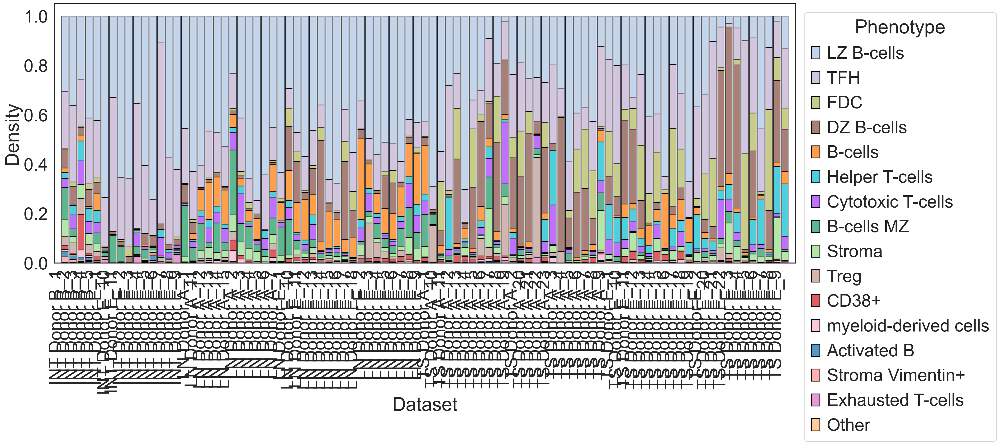

In [13]:
var = 'Phenotype' 
df_cluster = pd.DataFrame()
df_cluster['Dataset'] = adata_foll.obs['Follicle_Id'].tolist()
df_cluster["Dataset"] = df_cluster["Dataset"].astype(str).astype('category')
df_cluster[var] = adata_foll.obs[var].tolist()
df_cluster_count = df_cluster.value_counts().to_frame('counts').reset_index()
df_cluster_count['Density'] = df_cluster_count.groupby("Dataset")["counts"].apply(lambda x: x / x.sum())

# Get cluster color matching heatmap
cluster_label_order = adata.uns[f'dendrogram_{var}']['categories_ordered']

colors = adata.uns[f"{var}_colors"]
labels = adata.obs[var].cat.categories.tolist()
colors_rgb = []
for color in colors:
    colors_rgb.append(matplotlib.colors.hex2color(color))
colors_rgb = np.array(colors_rgb) * 255
colors_rgb = colors_rgb.astype(np.uint8)

colors_rgb_dict = {k:v/255 for k,v in zip(labels, colors_rgb)}

# plot stacked barplot
sns.set_style('white')
with sns.plotting_context('talk', font_scale=2):
    fig, ax = plt.subplots(figsize=(25, 9))
    ax = sns.histplot(data=df_cluster_count, x="Dataset" , hue=var, weights='Density', discrete=True, multiple='stack', shrink=0.8, palette=colors_rgb_dict, edgecolor='k',)
    ax.set_ylabel('Density')

    # Fix the legend so it's not on top of the bars.
    legend = ax.get_legend()
    legend.set_bbox_to_anchor((1, 1))
    ax.margins(x=0.01)
    plt.xticks(rotation=90, ha='right')


In [14]:
df_table = df_cluster_count.pivot_table(index='Dataset', columns='Phenotype', values='Density')
df_table = df_table.join(df_morph)

In [15]:
print(df_table.columns)

Index(['Activated B', 'B-cells', 'B-cells MZ', 'CD38+', 'Cytotoxic T-cells',
       'DZ B-cells', 'Exhausted T-cells', 'FDC', 'Helper T-cells',
       'LZ B-cells', 'Other', 'Stroma', 'Stroma Vimentin+', 'TFH', 'Treg',
       'myeloid-derived cells', 'Region_label', 'area', 'eccentricity', 'col',
       'row', 'min_row', 'min_col', 'max_row', 'max_col', 'orientation',
       'axis_major_length', 'axis_minor_length', 'COL'],
      dtype='object')


In [16]:
# follicles = df_table.sort_values('TFH', ascending=True).iloc[-20:].index.tolist()
# markers_list = ['CD4', 'CXCR5', 'PD1']

# for f in follicles:
#     print(f)
    
#     # Get mask and cell data
#     d, label = f.split('_')
#     adata_d = adata[adata.obs.Dataset == d]
#     mask_d = masks_follicle[d]
        
#     # Read follicle info
#     path = data_path = data_dir / "follicle" / f"{d}.csv"
#     df_foll = pd.read_csv(path)
#     info = df_foll[df_foll.Region_label == int(label)]
#     min_row = info.min_row.item() 
#     min_col = info.min_col.item() 
#     max_row = info.max_row.item()
#     max_col = info.max_col.item()
    
#     # ---- Get individual follicle, contour, and marker image 
#     crop_labeled_img = (mask_d[min_row:max_row, min_col: max_col] == int(label))
#     crop_clustered_img = clustered_imgs_dict[d][min_row:max_row, min_col: max_col]
#     contours = measure.find_contours(crop_labeled_img, 0.8)
    
#     crop_regions = []
#     for marker in markers_list:
#         crop_region = imgs_dict[d][marker][min_row:max_row, min_col: max_col]
#         crop_regions.append(crop_region)
    
#     #--- Multiplex plot
#     fig, ax = plt.subplots(figsize=(10,10), facecolor='k')
#     ax.set_facecolor('k')
#     img_combined = create_combined(crop_regions[:3])
#     # ax.imshow(crop_clustered_img)
#     ax.imshow(img_combined)
#     for contour in contours:
#         ax.plot(contour[:, 1], contour[:, 0], linewidth=5, color='white')
#     ax.axis('off')

#     plt.show()

In [ ]:
follicles = df_table.sort_values('DZ B-cells', ascending=False).head(5).index.tolist()

for f in follicles:
    print(f)
    
    # Get mask and cell data
    d, label = f.split('_')
    adata_d = adata[adata.obs.Dataset == d]
    mask_d = masks_follicle[d]
        
    # Read follicle info
    path = data_path = data_dir / "follicle" / f"{d}.csv"
    df_foll = pd.read_csv(path)
    info = df_foll[df_foll.Region_label == int(label)]
    min_row = info.min_row.item() 
    min_col = info.min_col.item() 
    max_row = info.max_row.item()
    max_col = info.max_col.item()
    
    # ---- Get individual follicle, contour, and marker image 
    crop_labeled_img = (mask_d[min_row:max_row, min_col: max_col] == int(label))
    crop_clustered_img = clustered_imgs_dict[d][min_row:max_row, min_col: max_col]
    contours = measure.find_contours(crop_labeled_img, 0.8)
    
    crop_regions = []
    for marker in markers_list:
        crop_region = imgs_dict[d][marker][min_row:max_row, min_col: max_col]
        crop_regions.append(crop_region)
    
    #--- Multiplex plot
    fig, ax = plt.subplots(1,3,figsize=(28,10))

    img_combined = create_combined(crop_regions[:3])
    ax[0].imshow(img_combined)
    for contour in contours:
        ax[0].plot(contour[:, 1], contour[:, 0], linewidth=2, color='white')

    img_combined = create_combined(crop_regions[3:])
    ax[1].imshow(img_combined)
    for contour in contours:
        ax[1].plot(contour[:, 1], contour[:, 0], linewidth=2, color='white')

    ax[2].imshow(crop_clustered_img)
    for contour in contours:
        ax[2].plot(contour[:, 1], contour[:, 0], linewidth=2, color='white')
    ax[0].axis('off')
    ax[1].axis('off')
    ax[2].axis('off') 
    rainbow_text(0.02, 0.9, markers_list, ['magenta', 'lime', 'cyan'], ax=ax[0], size=40)
    rainbow_text(0.02, 0.9, markers_list[3:], ['magenta', 'lime', 'cyan'], ax=ax[1], size=40)

    fig.subplots_adjust(wspace=0.01)
    plt.show()

In [ ]:
follicles = df_table.sort_values('FDC', ascending=False).head(7).index.tolist()

for f in follicles:
    print(f)
    
    # Get mask and cell data
    d, label = f.split('_')
    adata_d = adata[adata.obs.Dataset == d]
    mask_d = masks_follicle[d]
        
    # Read follicle info
    path = data_path = data_dir / "follicle" / f"{d}.csv"
    df_foll = pd.read_csv(path)
    info = df_foll[df_foll.Region_label == int(label)]
    min_row = info.min_row.item() 
    min_col = info.min_col.item() 
    max_row = info.max_row.item()
    max_col = info.max_col.item()
    
    # ---- Get individual follicle, contour, and marker image 
    crop_labeled_img = (mask_d[min_row:max_row, min_col: max_col] == int(label))
    crop_clustered_img = clustered_imgs_dict[d][min_row:max_row, min_col: max_col]
    contours = measure.find_contours(crop_labeled_img, 0.8)
    
    crop_regions = []
    for marker in markers_list:
        crop_region = imgs_dict[d][marker][min_row:max_row, min_col: max_col]
        crop_regions.append(crop_region)
    
    #--- Multiplex plot
    fig, ax = plt.subplots(1,3,figsize=(28,10))

    img_combined = create_combined(crop_regions[:3])
    ax[0].imshow(img_combined)
    for contour in contours:
        ax[0].plot(contour[:, 1], contour[:, 0], linewidth=2, color='white')

    img_combined = create_combined(crop_regions[3:])
    ax[1].imshow(img_combined)
    for contour in contours:
        ax[1].plot(contour[:, 1], contour[:, 0], linewidth=2, color='white')

    ax[2].imshow(crop_clustered_img)
    for contour in contours:
        ax[2].plot(contour[:, 1], contour[:, 0], linewidth=2, color='white')
    ax[0].axis('off')
    ax[1].axis('off')
    ax[2].axis('off') 
    rainbow_text(0.02, 0.9, markers_list, ['magenta', 'lime', 'cyan'], ax=ax[0], size=40)
    rainbow_text(0.02, 0.9, markers_list[3:], ['magenta', 'lime', 'cyan'], ax=ax[1], size=40)

    fig.subplots_adjust(wspace=0.01)
    plt.show()

# Plot follicle orientation on cluster map

In [19]:
def get_contour(mask: np.ndarray):
    """
    Get contours of mask
    """
    contours = []
    for i in sorted(np.unique(mask)):
        if i == 0:
            continue
        contours.append(measure.find_contours(mask == i, 0.8)[0])

    return contours

def contrast_streching(img):
    p2, p98 = np.percentile(img, (1, 99))
    img = exposure.rescale_intensity(img, in_range=(p2, p98), out_range=(0, 255)).astype(np.uint8)
    return img

In [20]:
from matplotlib.colors import LinearSegmentedColormap, ListedColormap

# get colormap
ncolors = 250
color_array = plt.get_cmap('hot')(range(ncolors))

# change alpha values
color_array[:,-1] = np.zeros(ncolors)
color_array[ncolors//2:, -1] = np.linspace(0.0, 1.0, ncolors//2)

# create a colormap object
mycmap= LinearSegmentedColormap.from_list(name='mycmap', colors=color_array)


In [21]:
marker = 'COL1'
imgs_col = []

# Read COL1 images
for donor in donors:
    path = p_dir / "data" / "whole_stitched"/ donor / f"{marker}.tif"
    
    img = skimage.io.imread(path)

    img_col= contrast_streching(img)
    if donor == 'INT Donor B':
        img_col = img_col[:5000, :]
    imgs_col.append(img_col)

In [22]:
# read clustered images
bg_imgs = []
for donor in donors:
    path = p_dir / "figures" / "semi_supervised"/ 'clustered_final' / f'{donor}.png'
    
    img = skimage.io.imread(path)

    bg_imgs.append(img)

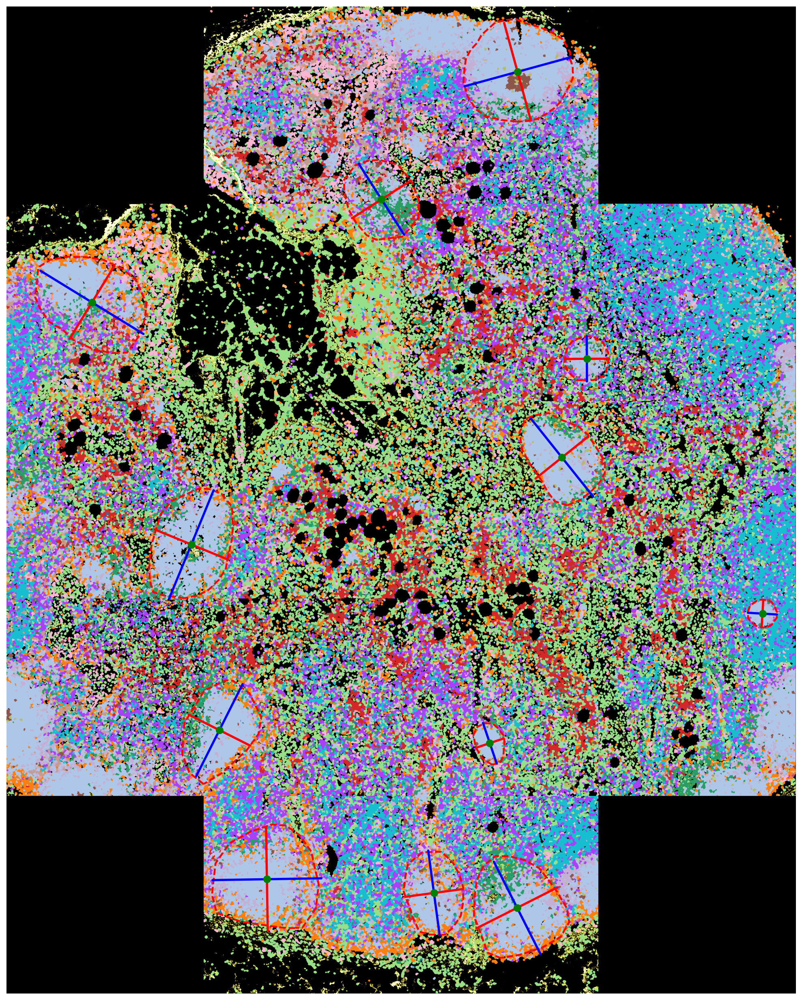

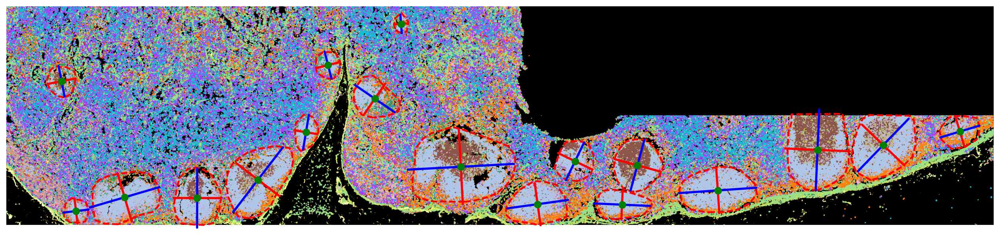

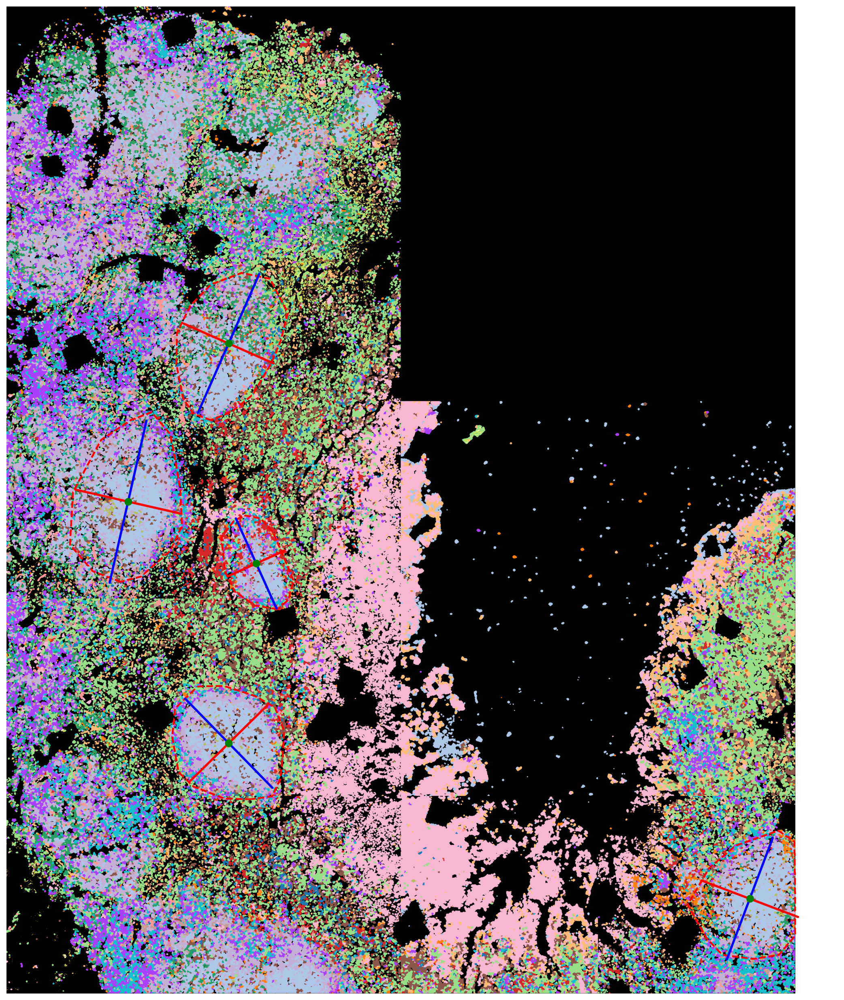

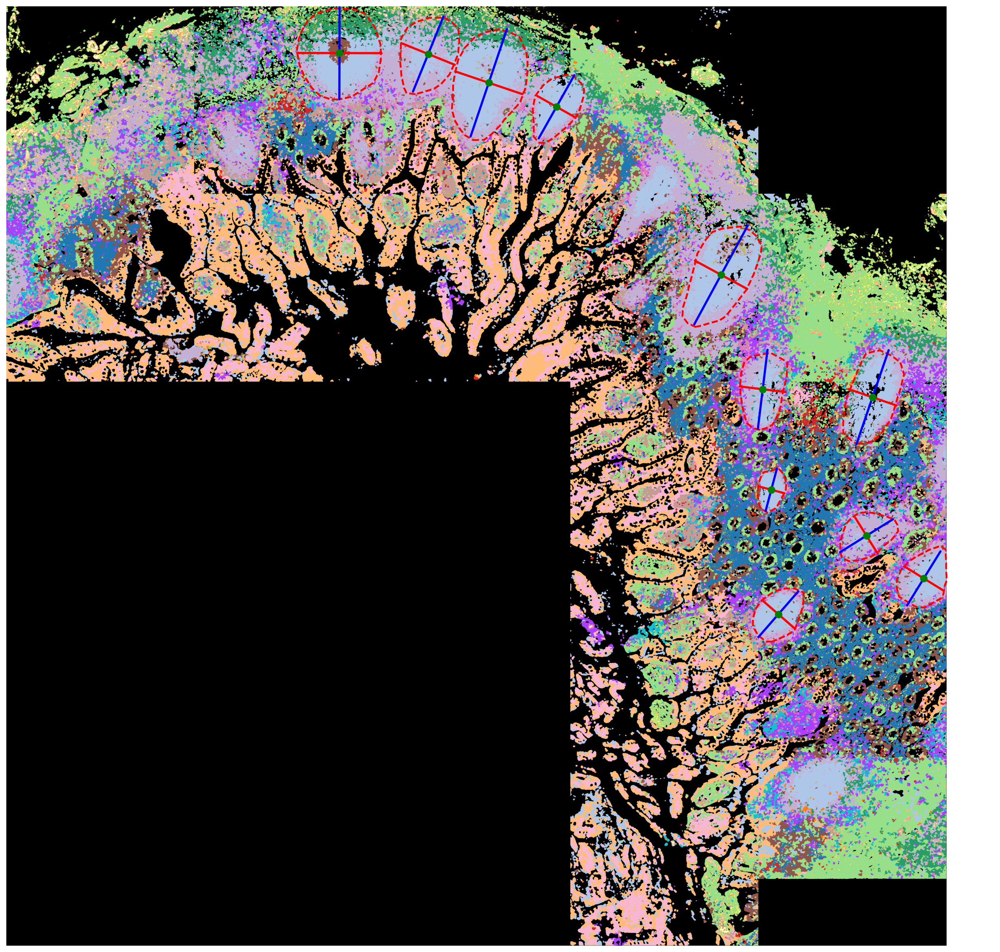

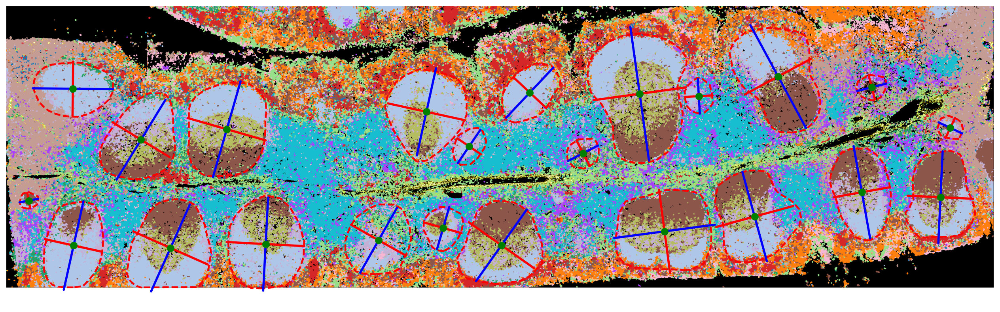

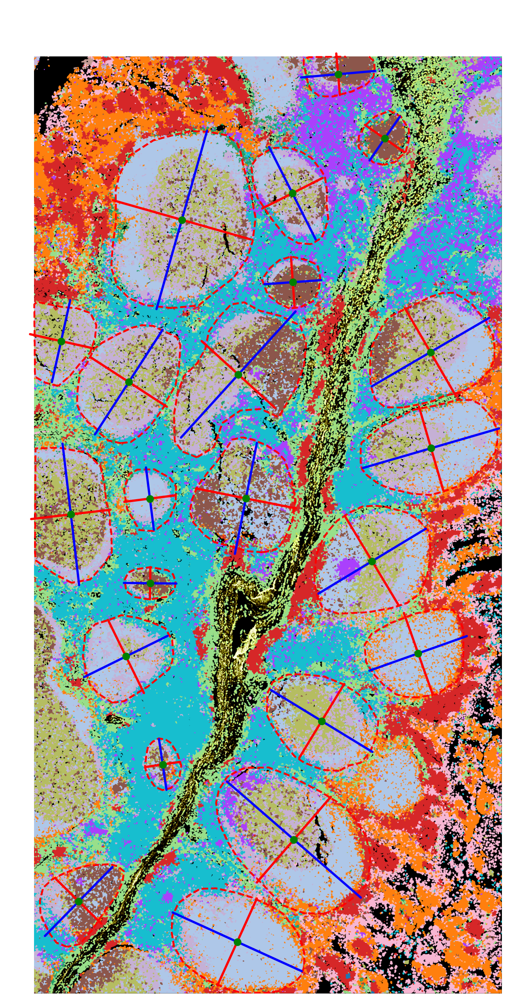

In [23]:
## Plot clustered images with col

sns.set_style('white')

for i in range(6):
    # Get COL image, clustered cell image and follicle mask
    img_col = imgs_col[i]
    img_bt = bg_imgs[i]
    mask = masks_follicle[donors[i]]
    
    # Get follcile mask info
    path = data_path = data_dir / "follicle" / f"{donors[i]}.csv"
    df = pd.read_csv(path)
    df = df[df.area > 1000]
   
    # Get follicle contours
    contours = get_contour(mask)
   
    # Plot images
    fig, ax = plt.subplots(figsize=(20,20))
    ax.imshow(img_bt, alpha=1)
    ax.imshow(img_col, cmap=mycmap, alpha=1) 
    for j, contour in enumerate(contours):
        ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color="red", linestyle='dashed')
    ax.axis("off")

    for row in df.itertuples():
        y0 = row.col
        x0 = row.row
        orientation = row.orientation
        axis_major_length = row.axis_major_length
        axis_minor_length = row.axis_minor_length
        minr = row.min_row
        minc = row.min_col
        maxr = row.max_row
        maxc = row.max_col

        x1 = x0 + math.cos(orientation) * 0.5 * axis_minor_length 
        y1 = y0 - math.sin(orientation) * 0.5 * axis_minor_length
        x1_bis = x0 + math.cos(np.pi + orientation) * 0.5 * axis_minor_length 
        y1_bis = y0 - math.sin(np.pi + orientation) * 0.5 * axis_minor_length

        x2 = x0 - math.sin(orientation) * 0.5 * axis_major_length
        y2 = y0 - math.cos(orientation) * 0.5 * axis_major_length
        x2_bis = x0 - math.sin(np.pi + orientation) * 0.5 * axis_major_length
        y2_bis = y0 - math.cos(np.pi + orientation) * 0.5 * axis_major_length

        ax.plot((x1_bis, x1), (y1_bis, y1), '-r', linewidth=2.5)
        ax.plot((x2_bis, x2), (y2_bis, y2), '-b', linewidth=2.5)
        ax.plot(x0, y0, '.g', markersize=15)

        bx = (minc, maxc, maxc, minc, minc)
        by = (minr, minr, maxr, maxr, minr)
    
    save_path = p_dir / "figures" / "clustering" / f"COL_follcile{i}.png"
    fig.savefig(save_path, bbox_inches='tight',transparent=True, pad_inches=0)

# Compare follicle directionality

Orientation from skimage region props calculate: Angle between the 0th axis (rows) and the major axis of the ellipse that has the same second moments as the region, ranging from -pi/2 to pi/2 counter-clockwise

![Alt text](https://i.stack.imgur.com/0RTCD.png)

In [24]:
def get_contour(mask: np.ndarray):
    """
    Get contours of mask
    """
    contours = []
    for i in sorted(np.unique(mask)):
        if i == 0:
            continue
        contours.append(measure.find_contours(mask == i, 0.8)[0])

    return contours

def contrast_streching(img):
    p2, p98 = np.percentile(img, (5, 95))
    img = exposure.rescale_intensity(img, in_range=(p2, p98), out_range=(0, 255)).astype(np.uint8)
    return img

def circular_mean(weights, angles):
    x = y = 0.
    for angle, weight in zip(angles, weights):
        x += math.cos(angle) * weight
        y += math.sin(angle) * weight

    mean = math.atan2(y, x)
    if mean < 0:
        mean = 2*np.pi + mean
    return mean

In [25]:
N = 40
theta = np.linspace(0.0, 2 * np.pi, N+1, endpoint=True)
width = (2*np.pi) / N

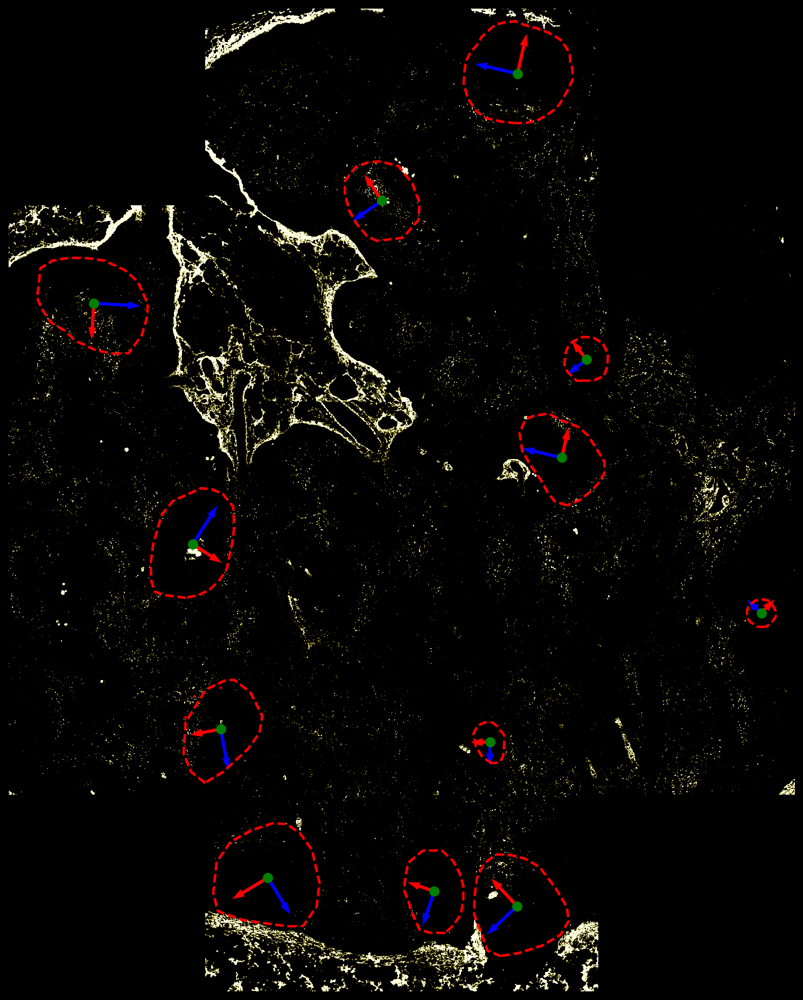

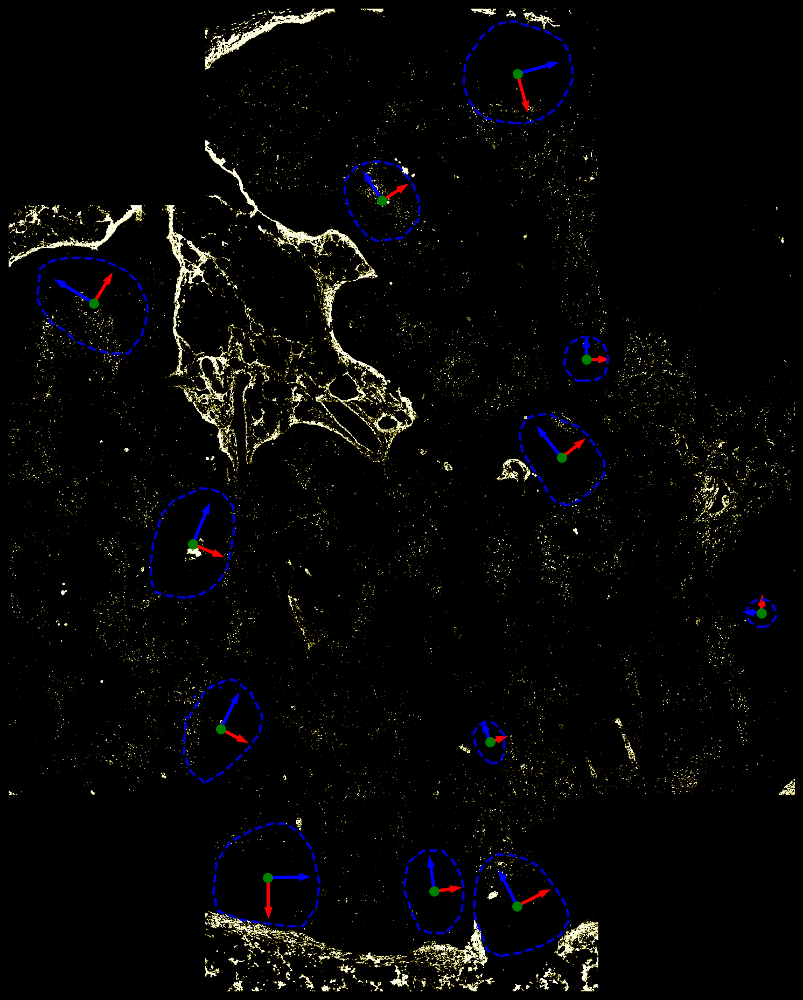

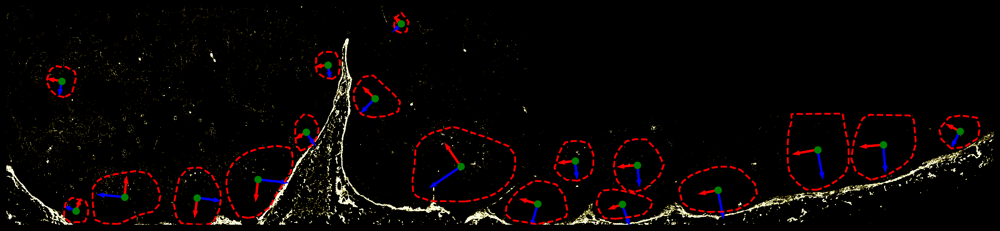

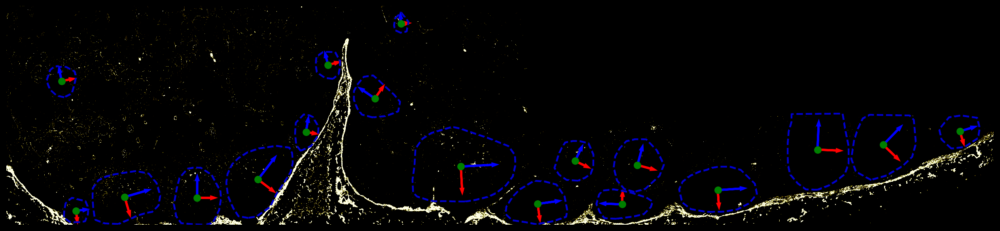

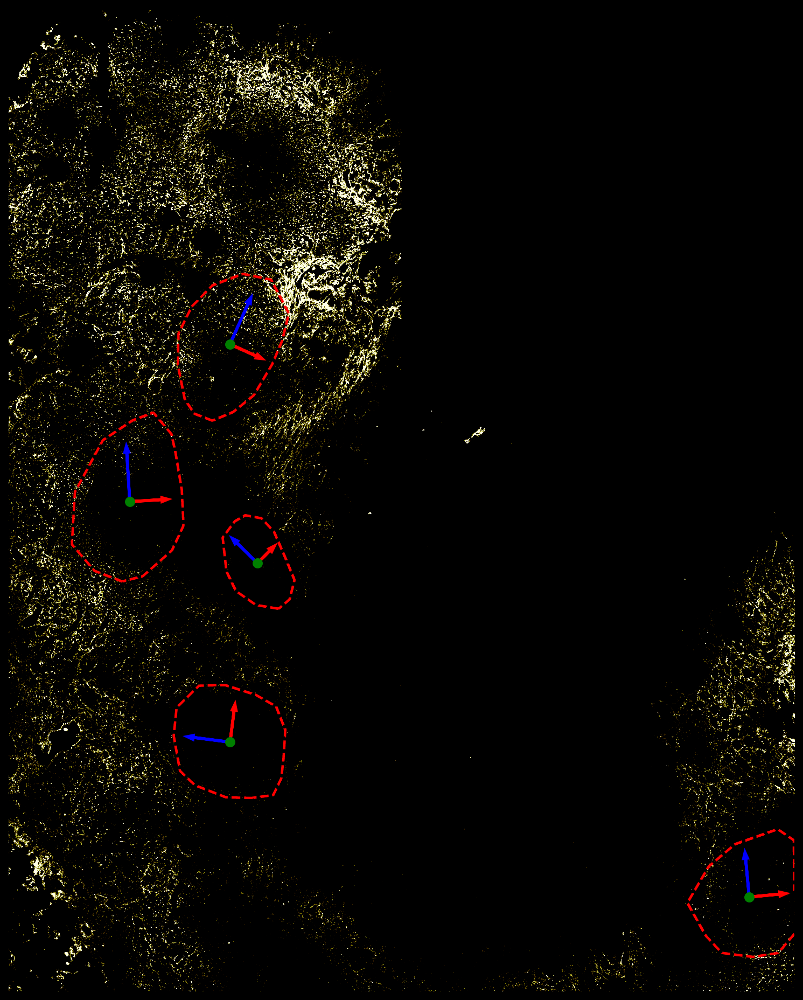

...

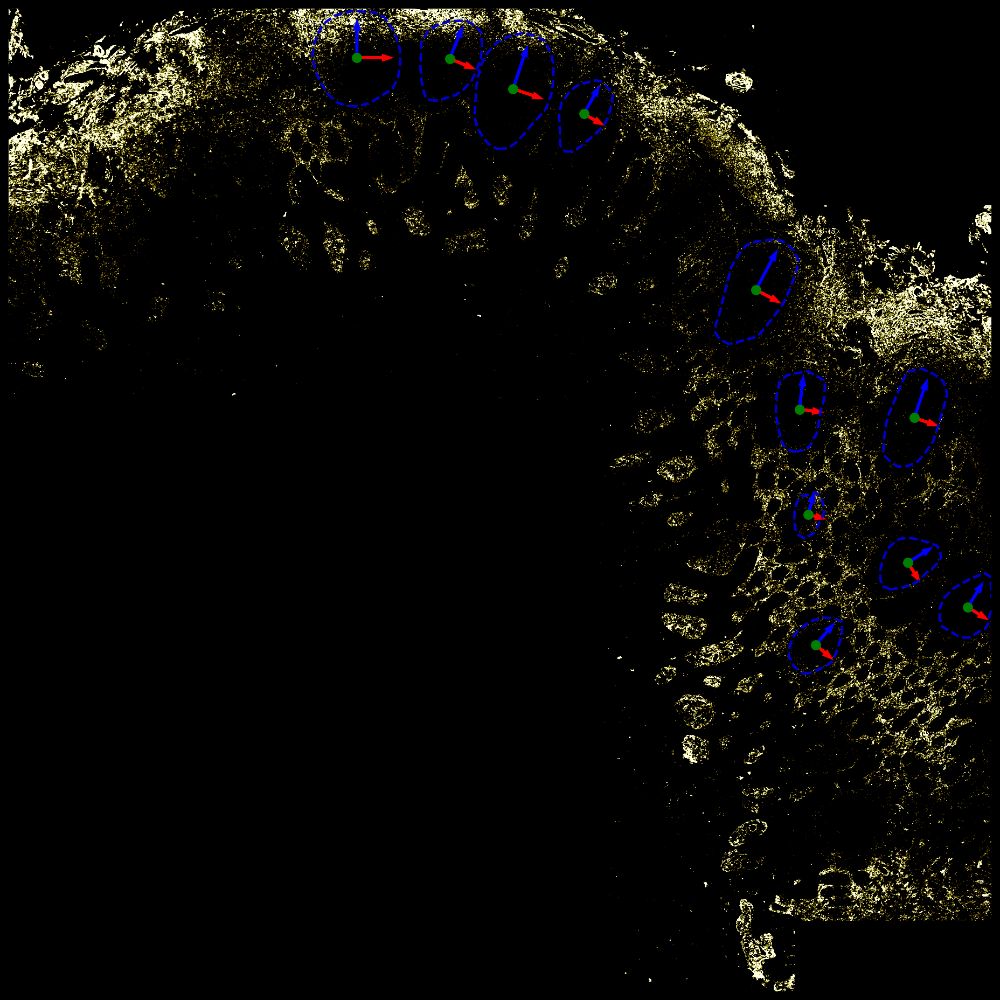

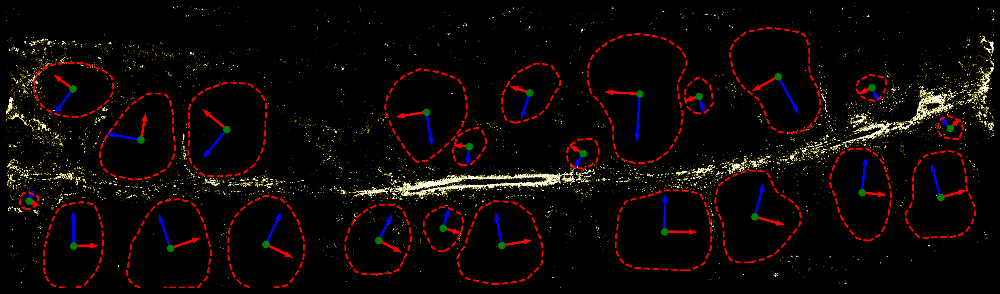

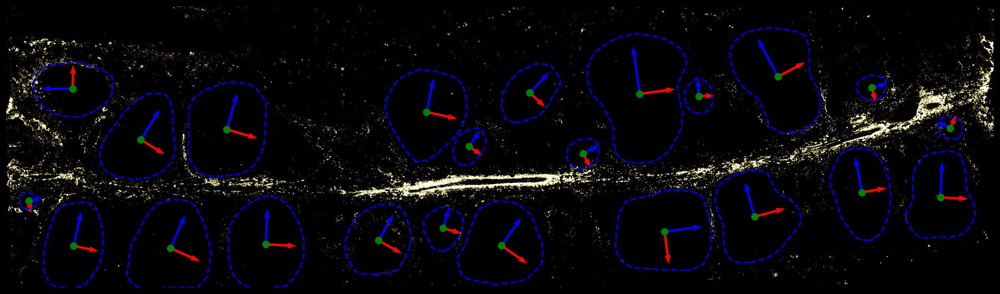

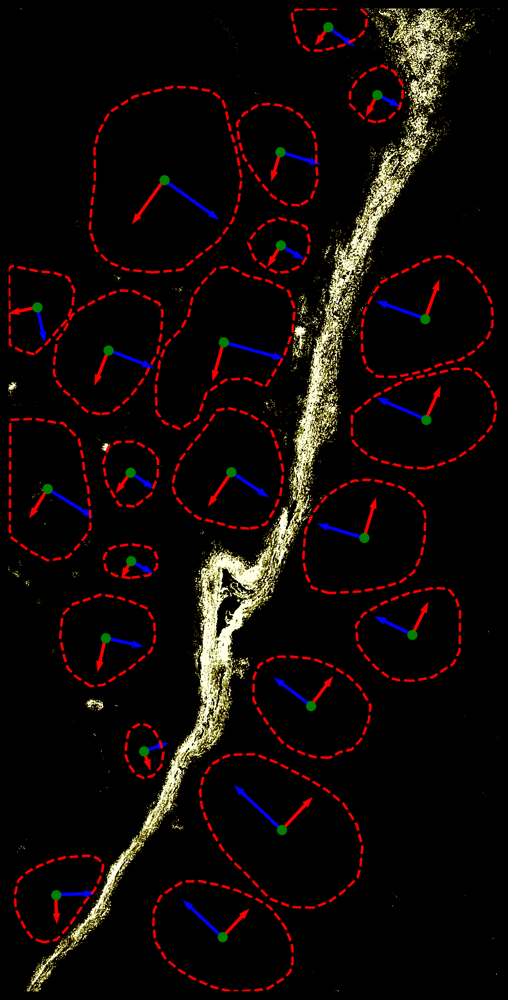

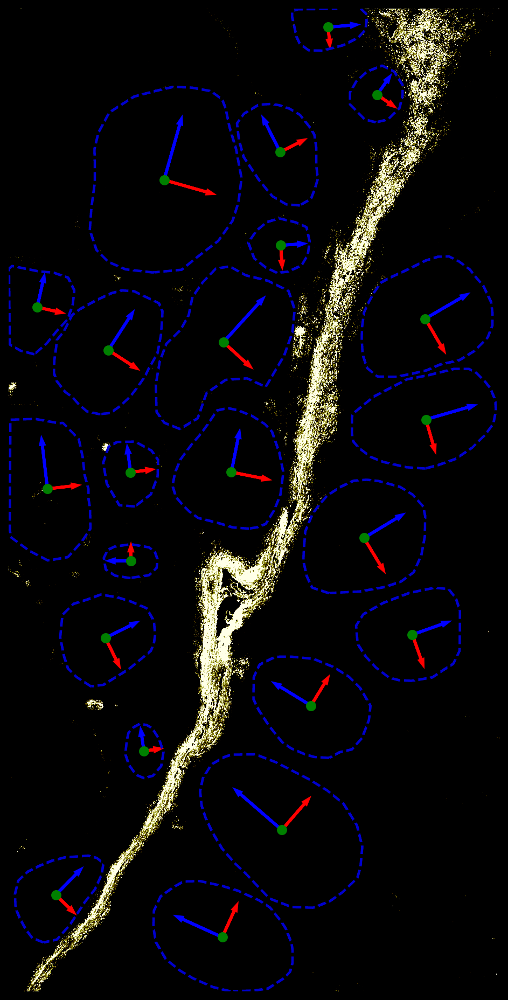

In [26]:
# Plot direction on masks

for i in range(len(donors)):
    
    # Read COL image and follicle mask
    img_col = imgs_col[i]
    mask = masks_follicle[donors[i]]
    
     # Make mask shape matchig img shape
    mask = mask[:img_col.shape[0], :img_col.shape[1]]
    r = img_col.shape[0] - mask.shape[0]
    c = img_col.shape[1] - mask.shape[1]
    mask = cv2.copyMakeBorder(mask, 0, r, 0, c, cv2.BORDER_CONSTANT, None, value = 0)
    
    # Read foll info
    path = data_path = data_dir / "follicle" / f"{donors[i]}.csv"
    df = pd.read_csv(path)
    df = df[df.area > 1000]
    
    # Get follicle contours
    contours = get_contour(mask)
    
    # Plot COL based orientation
    fig,ax = plt.subplots(figsize=(20,15), facecolor='k')
    ax.imshow(img_col, cmap=mycmap, alpha=1, vmax=150) 
    for j, contour in enumerate(contours):
        ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color="red", linestyle='dashed')
    for row in df.itertuples():
        # Get radius COL 
        rad = row.COL
        rad = rad.strip("[]").replace('\n','').split(" ")
        rad = np.array(list(filter(None, rad))).astype(float)

        # Get weighted average of count along polar direction
        mean = circular_mean(rad, theta[:-1])

        y0 = row.col
        x0 = row.row
        orientation = mean
        axis_major_length = row.axis_major_length
        axis_minor_length = row.axis_minor_length

        x1 = math.sin(orientation) * 0.3 * axis_minor_length
        y1 = math.cos(orientation) * 0.3 * axis_minor_length 
        x2 = math.cos(orientation) * 0.3 * axis_major_length
        y2 = -math.sin(orientation) * 0.3 * axis_major_length

        ax.arrow(x0, y0, x1, y1, color='r', linewidth=2.5, head_width=20)
        ax.arrow(x0, y0, x2, y2, color='b', linewidth=2.5, head_width=20)
        ax.plot(x0, y0, '.g', markersize=15)

    ax.grid(False)
    ax.axis('off')
    plt.show()
    
    # Plot COL based orientation
    fig,ax = plt.subplots(figsize=(20,15), facecolor='k')
    ax.imshow(img_col, cmap=mycmap, alpha=1, vmax=150) 
    for j, contour in enumerate(contours):
        ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color="mediumblue", linestyle='dashed')
    for row in df.itertuples():
        # Get radius COL 
        rad = row.COL
        rad = rad.strip("[]").replace('\n','').split(" ")
        rad = np.array(list(filter(None, rad))).astype(float)

        y0 = row.col
        x0 = row.row
        orientation =  row.orientation + np.pi/2 
        axis_major_length = row.axis_major_length
        axis_minor_length = row.axis_minor_length

        x1 = math.sin(orientation) * 0.3 * axis_minor_length
        y1 = math.cos(orientation) * 0.3 * axis_minor_length 
        x2 = math.cos(orientation) * 0.3 * axis_major_length
        y2 = -math.sin(orientation) * 0.3 * axis_major_length

        ax.arrow(x0, y0, x1, y1, color='r', linewidth=2.5, head_width=20)
        ax.arrow(x0, y0, x2, y2, color='b', linewidth=2.5, head_width=20)
        ax.plot(x0, y0, '.g', markersize=15)

    ax.grid(False)
    ax.axis('off')
    plt.show()


# Tissue Type

In [113]:
# Custom colormap
n = 3
jet = cm.get_cmap('rainbow', n)
custom = jet(np.linspace(0,1,n))
custom = np.vstack([np.array([[0,0,0,1]]), custom])
custom_cmap = ListedColormap(custom)


[0.0, 0.9424777960769379, 2.199114857512855, 3.141592653589793]
[3 3 1 3 1 3 1 3 3 2 2 2 3 3 3 2 2 3 3 3 2 3 2 3 3 2 2 3 3 3]


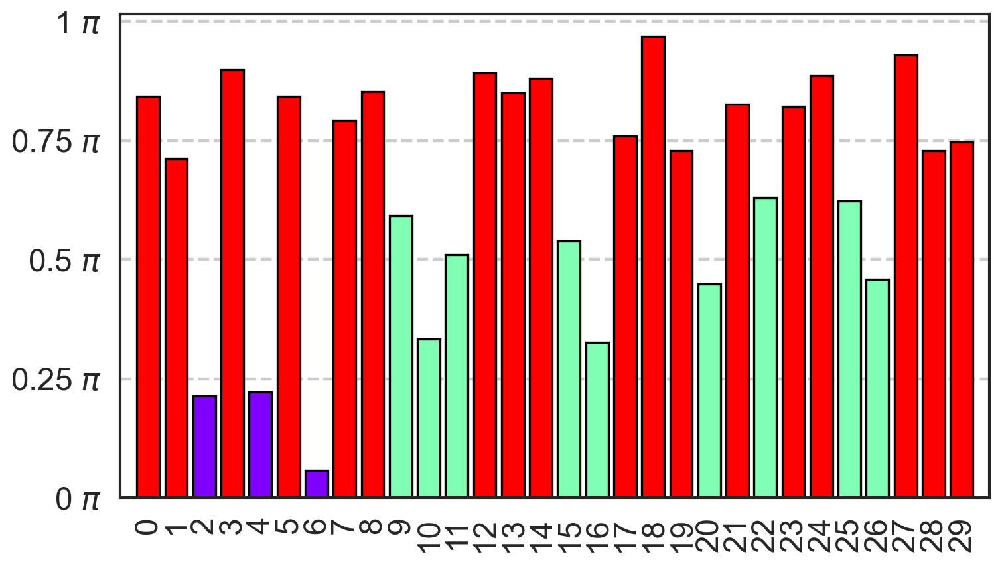

[0.0, 0.9424777960769379, 2.199114857512855, 3.141592653589793]
[1 1 1 1 1 2 2 2 2 1 3 2 1 2 3 2]


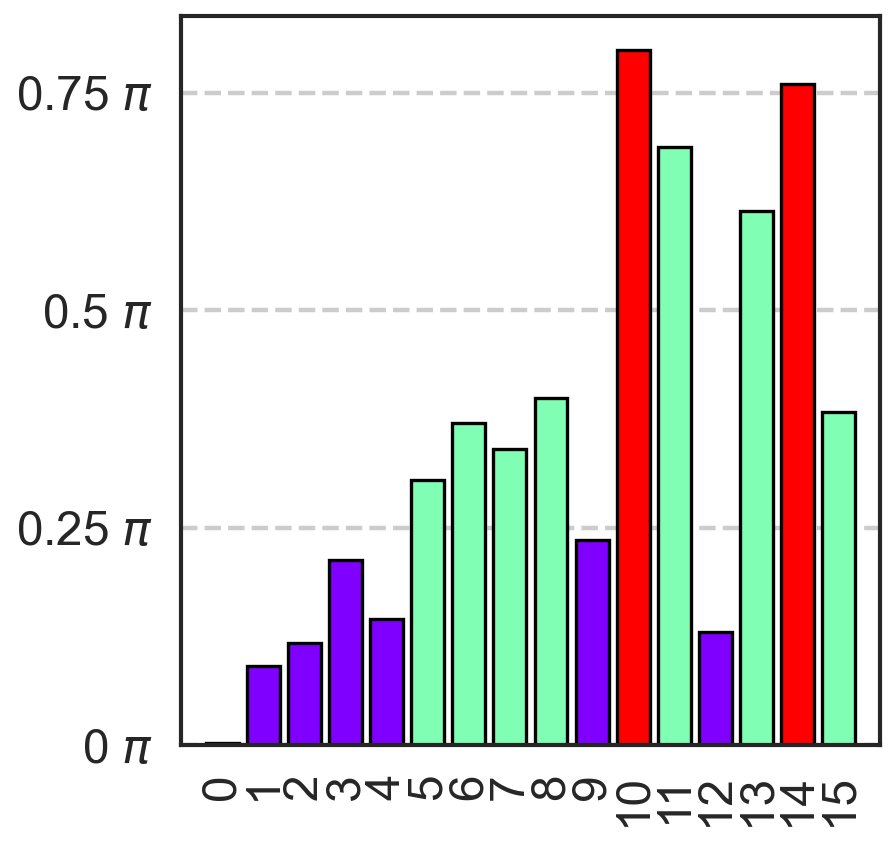

[0.0, 0.9424777960769379, 2.199114857512855, 3.141592653589793]
[2 2 2 1 1 3 1 1 1 3 3 1 3 3 3 3 2 2 1 1 1 1 3 3 2 1 3 2 3 3 3 2 1 2 3 3 3
 3 1 1 1 1 2 1 2]


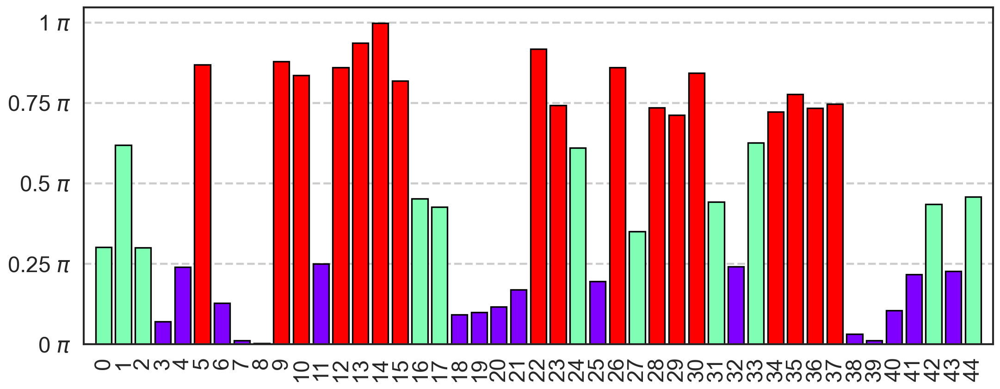

In [124]:
tissues = [['LN Donor A',
 'LN Donor E'],
 ['INT Donor B',
 'INT Donor E'],
 ['TS Donor A',
 'TS Donor E']]

for tissue in tissues:
    # Get per donor info
    dfs = []
    for donor in tissue:
        # Read follicle info
        path = data_path = data_dir / "follicle" / f"{donor}.csv"
        df = pd.read_csv(path)
        df = df[df.area > 1000]
        dfs.append(df)
    df = pd.concat(dfs)
    
    # Get difference between COL and form based analysis
    differences = []
    for row in df.itertuples():
        # Get radius COL 
        orientation = row.orientation + np.pi/2 
        rad = row.COL
        rad = rad.strip("[]").replace('\n','').split(" ")
        rad = np.array(list(filter(None, rad))).astype(float)

        # Get weighted average of count along polar direction
        mean = circular_mean(rad, theta[:-1])
        diff = min((2 * np.pi) - abs(mean - orientation), abs(mean - orientation))
        differences.append(diff)
        
    bin_edges = np.quantile(differences, q=[0.0, 0.35, 0.65, 1.0])
    bin_edges = [0.0, np.pi*0.3, np.pi*0.7, np.pi]
    bins = pd.cut(np.array(differences), bins=bin_edges, labels=np.arange(0,len(bin_edges)-1), include_lowest=True)
    bins = bins.to_numpy() + 1

    print(bin_edges)
    print(bins)
    
    with sns.plotting_context('talk', font_scale=1.3):
        fig ,ax=plt.subplots(figsize=(0.35*len(differences),6))
        x=np.arange(len(differences))

        ax.bar(x,np.array(differences)/np.pi, color=jet(bins-1), edgecolor='k')
        ax.set_xticks(x)
        ax.yaxis.set_major_formatter(tck.FormatStrFormatter('%g $\pi$'))
        ax.yaxis.set_major_locator(tck.MultipleLocator(base=0.25))
        ax.grid(which='major', axis='y', linewidth=2, linestyle='--')
        ax.set_xlim(-1, len(differences))
        # ax.set_ylim(-0.05, 1.0)
        plt.xticks(rotation=90, ha='center')
        plt.show()

# Individual tissue

In [103]:
import seaborn as sns 

sns.set_style('white')
donors

In [100]:
i = 3
# Read follicle info
path = data_path = data_dir / "follicle" / f"{donors[i]}.csv"
df = pd.read_csv(path)
df = df[df.area > 1000]

In [101]:
# N = 40
# theta = np.linspace(0.0, 2 * np.pi, N+1, endpoint=True)
# width = (2*np.pi) / N

# for row in df.itertuples():
#     # Get radius COL 
#     orientation = row.orientation + np.pi/2 
#     rad = row.COL
#     rad = rad.strip("[]").replace('\n','').split(" ")
#     rad = np.array(list(filter(None, rad))).astype(float)
    
#     # Get weighted average of count along polar direction
#     mean = circular_mean(rad, theta[:-1])

#     # Plot count per angle and weighted average
#     cmap = cm.get_cmap('jet', 100)
#     ax = plt.subplot(111, polar=True)
#     ax.set_rticks([])
#     ax.vlines(mean, 0, 1, colors='m', zorder=3, linewidth=5)
#     ax.vlines(orientation, 0, 1, colors='darkgreen', zorder=3, linewidth=5)
#     bars = ax.bar(theta[:-1], rad, width=width)
#     # Use custom colors and opacity
#     for r, bar in zip(rad, bars):
#         bar.set_facecolor(cmap(r))
#         bar.set_alpha(0.8)
#     plt.show()
#     break

In [102]:
differences = []

for row in df.itertuples():
    # Get radius COL 
    orientation = row.orientation + np.pi/2 
    rad = row.COL
    rad = rad.strip("[]").replace('\n','').split(" ")
    rad = np.array(list(filter(None, rad))).astype(float)
    
    # Get weighted average of count along polar direction
    mean = circular_mean(rad, theta[:-1])
    diff = min((2 * np.pi) - abs(mean - orientation), abs(mean - orientation))
    differences.append(diff)


In [104]:
bin_edges = np.quantile(differences, q=[0.0, 0.35, 0.65, 1.0])
bin_edges = [0.0, np.pi*0.3, np.pi*0.7, np.pi]
bins = pd.cut(np.array(differences), bins=bin_edges, labels=np.arange(0,len(bin_edges)-1), include_lowest=True)
bins = bins.to_numpy() + 1

print(bin_edges)
print(bins)

[0.0, 0.9424777960769379, 2.199114857512855, 3.141592653589793]
[2 2 2 2 1 3 2 1 2 3 2]


In [105]:
# Custom colormap
n = 3
jet = cm.get_cmap('rainbow', n)
custom = jet(np.linspace(0,1,n))
custom = np.vstack([np.array([[0,0,0,1]]), custom])
custom_cmap = ListedColormap(custom)


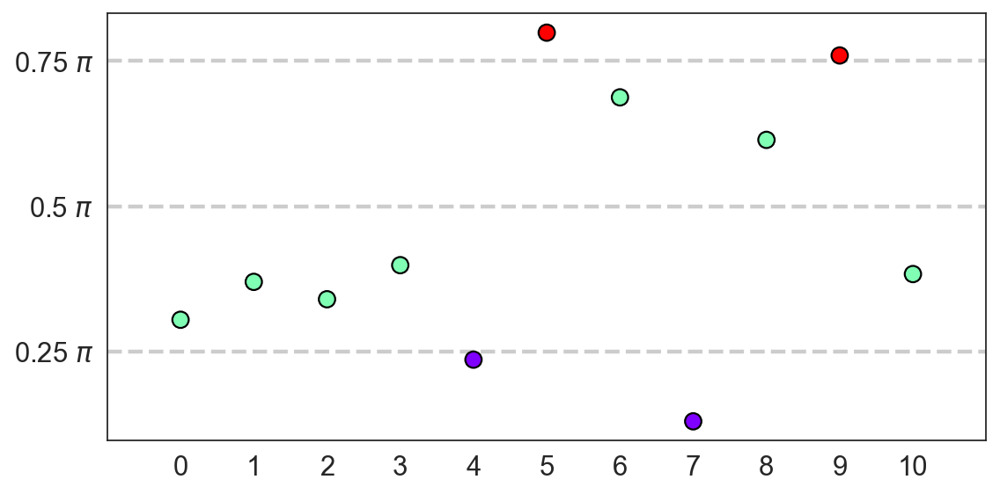

In [106]:
import matplotlib.ticker as tck

fig ,ax=plt.subplots(figsize=(8,4))
x=np.arange(len(differences))

ax.scatter(x,np.array(differences)/np.pi, s=70, c=bins, cmap=jet, edgecolors='k')
ax.set_xticks(x)
ax.yaxis.set_major_formatter(tck.FormatStrFormatter('%g $\pi$'))
ax.yaxis.set_major_locator(tck.MultipleLocator(base=0.25))
ax.grid(which='major', axis='y', linewidth=2, linestyle='--')
ax.set_xlim(-1, len(differences))
# ax.set_ylim(-0.05, 1.0)
plt.show()

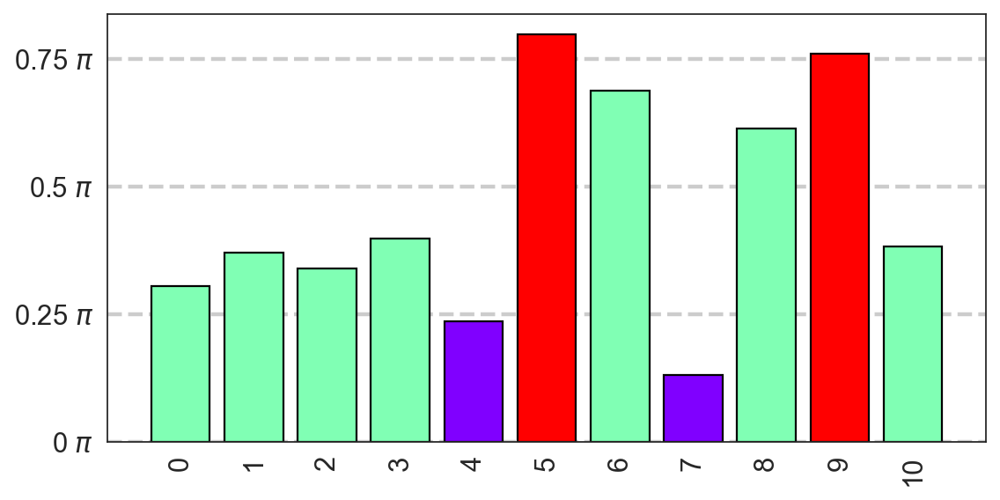

In [107]:
import matplotlib.ticker as tck

fig ,ax=plt.subplots(figsize=(8,4))
x=np.arange(len(differences))

ax.bar(x,np.array(differences)/np.pi, color=jet(bins-1), edgecolor='k')
ax.set_xticks(x)
ax.yaxis.set_major_formatter(tck.FormatStrFormatter('%g $\pi$'))
ax.yaxis.set_major_locator(tck.MultipleLocator(base=0.25))
ax.grid(which='major', axis='y', linewidth=2, linestyle='--')
ax.set_xlim(-1, len(differences))
# ax.set_ylim(-0.05, 1.0)
plt.xticks(rotation=90, ha='center')
plt.show()

In [29]:
# Read mask
mask_follicle = masks_follicle[donors[i]]

# Read COl and cluster img
img_col = imgs_col[i]
img_bt = bg_imgs[i]

# Append mask follicle to match size of img
mask_follicle = cv2.copyMakeBorder(mask_follicle, 0, max(0, img_col.shape[0]-mask_follicle.shape[0]), 
                                   0, max(0, img_col.shape[1]-mask_follicle.shape[1]), cv2.BORDER_CONSTANT, None, value = 0)


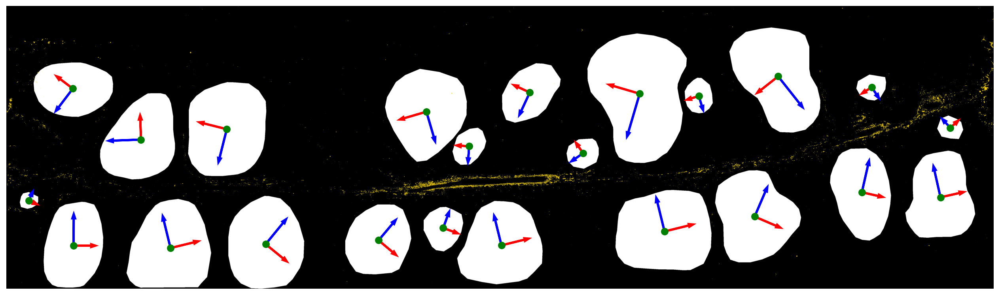

In [30]:
# Plot COL based orientation

fig,ax = plt.subplots(figsize=(20,15))
ax.imshow(mask_follicle > 0, cmap=plt.cm.gray)
ax.imshow(img_col, cmap=mycmap, alpha=1) 

for row in df.itertuples():
    # Get radius COL 
    rad = row.COL
    rad = rad.strip("[]").replace('\n','').split(" ")
    rad = np.array(list(filter(None, rad))).astype(float)
    
    # Get weighted average of count along polar direction
    mean = circular_mean(rad, theta[:-1])

    y0 = row.col
    x0 = row.row
    orientation = mean
    axis_major_length = row.axis_major_length
    axis_minor_length = row.axis_minor_length

    x1 = math.sin(orientation) * 0.3 * axis_minor_length
    y1 = math.cos(orientation) * 0.3 * axis_minor_length 
    x2 = math.cos(orientation) * 0.3 * axis_major_length
    y2 = -math.sin(orientation) * 0.3 * axis_major_length

    ax.arrow(x0, y0, x1, y1, color='r', linewidth=2.5, head_width=20)
    ax.arrow(x0, y0, x2, y2, color='b', linewidth=2.5, head_width=20)
    ax.plot(x0, y0, '.g', markersize=15)

ax.grid(False)
ax.axis('off')
plt.show()

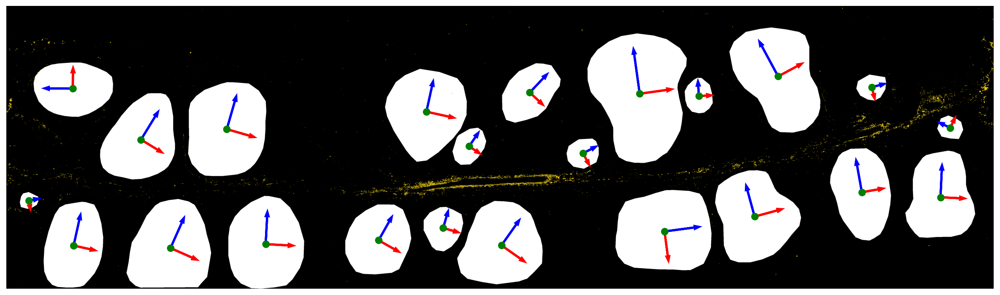

In [31]:
# Plot morpholgy based orientation

fig,ax = plt.subplots(figsize=(20,15))
ax.imshow(mask_follicle > 0, cmap=plt.cm.gray)
ax.imshow(img_col, cmap=mycmap, alpha=1) 

for row in df.itertuples():
    y0 = row.col
    x0 = row.row
    orientation = row.orientation + np.pi/2 
    axis_major_length = row.axis_major_length
    axis_minor_length = row.axis_minor_length
    minr = row.min_row
    minc = row.min_col
    maxr = row.max_row
    maxc = row.max_col
    
    x1 = math.sin(orientation) * 0.3 * axis_minor_length
    y1 = math.cos(orientation) * 0.3 * axis_minor_length 
    x2 = math.cos(orientation) * 0.3 * axis_major_length
    y2 = -math.sin(orientation) * 0.3 * axis_major_length

    ax.arrow(x0, y0, x1, y1, color='r', linewidth=2.5, head_width=20)
    ax.arrow(x0, y0, x2, y2, color='b', linewidth=2.5, head_width=20)
    ax.plot(x0, y0, '.g', markersize=15)
    
ax.grid(False)
ax.axis('off')
plt.show()

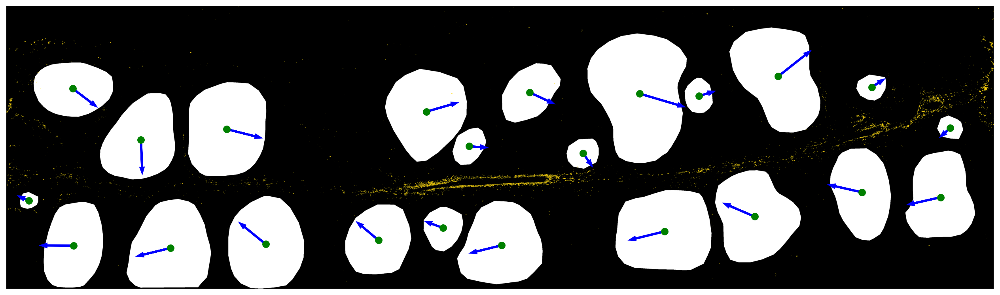

In [32]:
# Plot COL based orientation

fig,ax = plt.subplots(figsize=(20,15))
ax.imshow(mask_follicle > 0, cmap=plt.cm.gray)
ax.imshow(img_col, cmap=mycmap, alpha=1) 

for row in df.itertuples():
    # Get radius COL 
    rad = row.COL
    rad = rad.strip("[]").replace('\n','').split(" ")
    rad = np.array(list(filter(None, rad))).astype(float)
    orientation = row.orientation + np.pi/2 
    
    # Get weighted average of count along polar direction
    mean = circular_mean(rad, theta[:-1])
    diff = min((2 * np.pi) - abs(mean - orientation), abs(mean - orientation))

    y0 = row.col
    x0 = row.row
    orientation =  mean
    axis_major_length = row.axis_major_length
    axis_minor_length = row.axis_minor_length

    x2 = math.sin(orientation) * 0.3 * axis_major_length
    y2 = math.cos(orientation) * 0.3 * axis_major_length
    
    ax.arrow(x0, y0, -x2, -y2, color='b', linewidth=2.5, head_width=20)
    ax.plot(x0, y0, '.g', markersize=15)

ax.grid(False)
ax.axis('off')
plt.show()

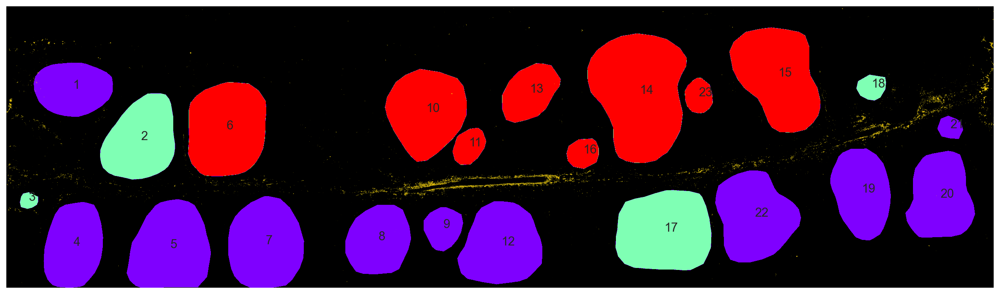

In [33]:

# Plot morpholgy based orientation
fig,ax = plt.subplots(figsize=(20,15))

mask_colored = mask_follicle.copy()

for j, row in enumerate(df.itertuples()):
    label = row.Region_label
    mask_colored = np.where(mask_colored == label, bins[j], mask_colored)
    
ax.imshow(mask_colored, cmap=custom_cmap)
ax.imshow(img_col, cmap=mycmap, alpha=1) 

for j, row in enumerate(df.itertuples()):
    label = row.Region_label
    y0 = row.col
    x0 = row.row
    
    ax.text(x0, y0, label)

ax.grid(False)
ax.axis('off')
plt.show()

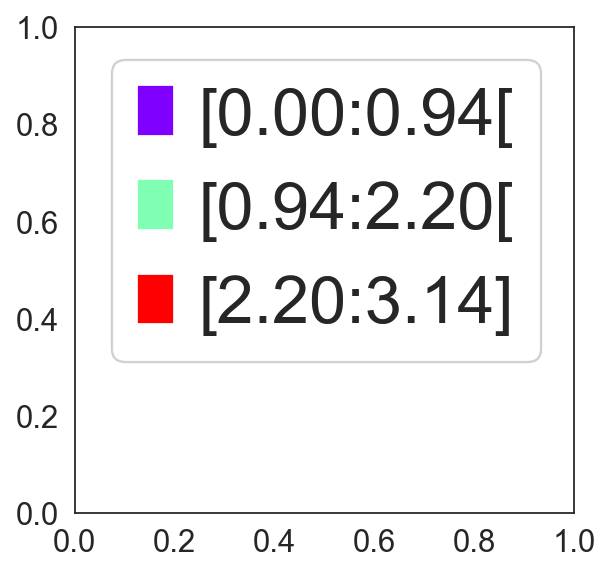

In [34]:
from matplotlib import pyplot as plt
import matplotlib.patches as mpatches

fig, ax = plt.subplots()

patch1 = mpatches.Patch(color=custom[1], label=f'[{bin_edges[0]:.2f}:{bin_edges[1]:.2f}[')
patch2 = mpatches.Patch(color=custom[2], label=f'[{bin_edges[1]:.2f}:{bin_edges[2]:.2f}[')
patch3 = mpatches.Patch(color=custom[3], label=f'[{bin_edges[2]:.2f}:{bin_edges[3]:.2f}]')

all_handles = (patch1, patch2, patch3)

leg = ax.legend(handles=all_handles, prop={'size': 30})

ax.add_artist(leg)
plt.show()

In [41]:
# # Plot COL based orientation

# fig,ax = plt.subplots(figsize=(20,15))
# ax.imshow(mask_follicle > 0, cmap=plt.cm.gray)
# ax.imshow(img_col, cmap=mycmap, alpha=1) 

# for row in df.itertuples():
#     # Get radius COL 
#     rad = row.COL
#     rad = rad.strip("[]").replace('\n','').split(" ")
#     rad = np.array(list(filter(None, rad))).astype(float)
    
#     # Get weighted average of count along polar direction
#     mean = circular_mean(rad, theta[:-1])
    
#     y0 = row.col
#     x0 = row.row
#     orientation = mean
#     axis_major_length = row.axis_major_length
#     axis_minor_length = row.axis_minor_length

#     x1 = x0+math.sin(orientation) * 0.3 * axis_minor_length
#     y1 = y0+math.cos(orientation) * 0.3 * axis_minor_length 
#     x2 = x0+math.cos(orientation) * 0.3 * axis_major_length
#     y2 = y0-math.sin(orientation) * 0.3 * axis_major_length

#     ax.plot((x0, x1), (y0, y1), '-r', linewidth=2.5)
#     ax.plot((x0, x2), (y0, y2), '-b', linewidth=2.5)
#     ax.plot(x0, y0, '.g', markersize=15)

# ax.grid(False)
# ax.axis('off')
# plt.show()

# Extract single-cell marker gradient from COL based orientation and shape based orientation

In [36]:
def scalar_projection(b, points, start):
    p = points - start

    return p.dot(b)

def get_projection(start, coords, orientation, row):
    y0, x0 = start
    axis_major_length = row.axis_major_length
    axis_minor_length = row.axis_minor_length
    x1 = x0+math.sin(orientation) * 0.5 * axis_minor_length
    y1 = y0+math.cos(orientation) * 0.5 * axis_minor_length 
    x2 = x0+math.cos(orientation) * 0.5 * axis_major_length
    y2 = y0-math.sin(orientation) * 0.5 * axis_major_length

    b_major = np.array([y2-y0, x2-x0]) 
    b_minor = np.array([y1-y0, x1-x0]) 

    b_major = b_major/np.linalg.norm(b_major)
    b_minor = b_minor/np.linalg.norm(b_minor)

    x_proj = scalar_projection(b_major, coords, start)
    y_proj = scalar_projection(b_minor, coords, start)
    
    return x_proj, y_proj, (x1, y1), (x2, y2)


In [ ]:
adata_folls = []

for i in range(len(donors)):
    # Read follicle info
    path = data_path = data_dir / "follicle" / f"{donors[i]}.csv"
    df = pd.read_csv(path)
    df = df[df.area > 1000]
                   
    # Get donor adata
    adata_donor = adata[adata.obs.Dataset == donors[i]]
    X_spatial = np.array(adata_donor.obsm['spatial'])[:, [1,0]]

    # Read mask
    mask_follicle = masks_follicle[donors[i]]

    # Read COl and cluster img
    img_col = imgs_col[i]
    img_bt = bg_imgs[i]

    # Append mask follicle to match size of img
    mask_follicle = cv2.copyMakeBorder(mask_follicle, 0, max(0, img_col.shape[0]-mask_follicle.shape[0]), 
                                       0, max(0, img_col.shape[1]-mask_follicle.shape[1]), cv2.BORDER_CONSTANT, None, value = 0)

    for row in tqdm(df.itertuples(), total=len(df)):
        # Get radius COL 
        orientation = row.orientation + np.pi/2 
        rad = row.COL
        rad = rad.strip("[]").replace('\n','').split(" ")
        rad = np.array(list(filter(None, rad))).astype(float)

        # Get weighted average of count along polar direction
        mean = circular_mean(rad, theta[:-1])

        # Get mask centroid
        y0 = row.col
        x0 = row.row
        start = np.array([y0, x0])

        # Get mask
        mask = mask_follicle == row.Region_label

        # Get cell indices in mask
        in_mask = mask[tuple(X_spatial.astype(int).T)]
        adata_foll = adata_donor[in_mask].copy()
        coords =  np.array(adata_foll.obsm['spatial'])[:, [1,0]]

        # Proj into minor and major 
        x_proj, y_proj, _, _ = get_projection(start, coords, mean, row)

        adata_foll.obs['Major_Col'] = x_proj
        adata_foll.obs['Minor_Col'] = y_proj 

        x_proj, y_proj, _, _ = get_projection(start, coords, orientation, row)

        adata_foll.obs['Major_Mor'] = x_proj
        adata_foll.obs['Minor_Mor'] = y_proj 

        adata_foll.obs['Foll'] = row.Region_label

        adata_folls.append(adata_foll)

In [44]:
adata_foll_all = ad.concat(adata_folls)

In [46]:
adata_foll_all.write('foll.h5ad')

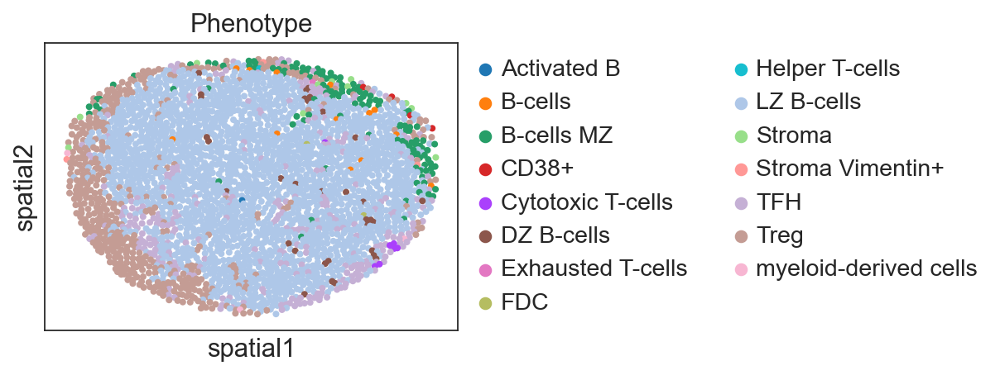

In [52]:
sc.pl.spatial(adata_foll, color='Phenotype', spot_size=10)

## Visual inspection

In [68]:
x_proj, y_proj, (x1, y1), (x2, y2) = get_projection(start, coords, orientation, row)

(-309.68993019657717,
 302.21650794483384,
 -219.0149134628934,
 204.3838127267104)

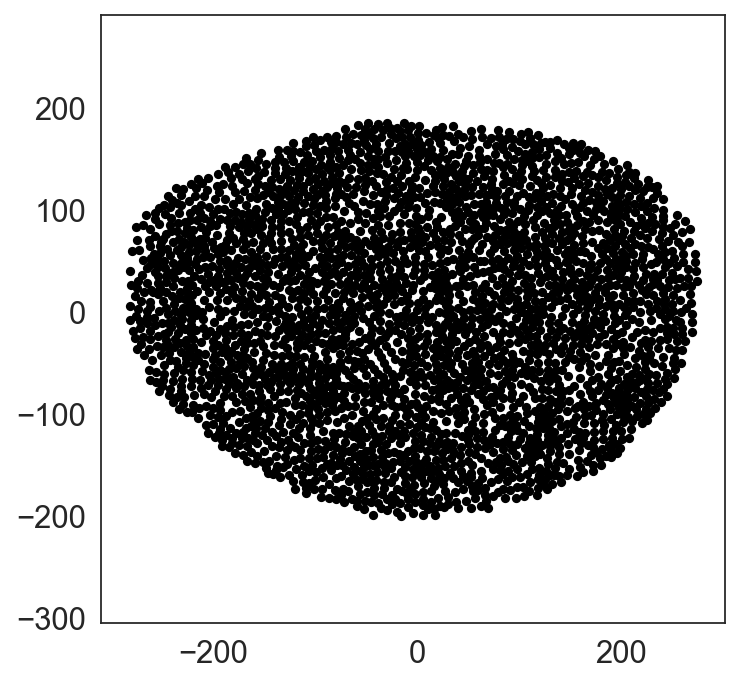

In [69]:
fig, ax = plt.subplots(figsize=(5,5))
ax.scatter(x_proj, y_proj, s=10, c='k')
ax.axis('equal')


(169.15650143678158, 780.9548491379311, 382.8238601823708, 806.045874945723)

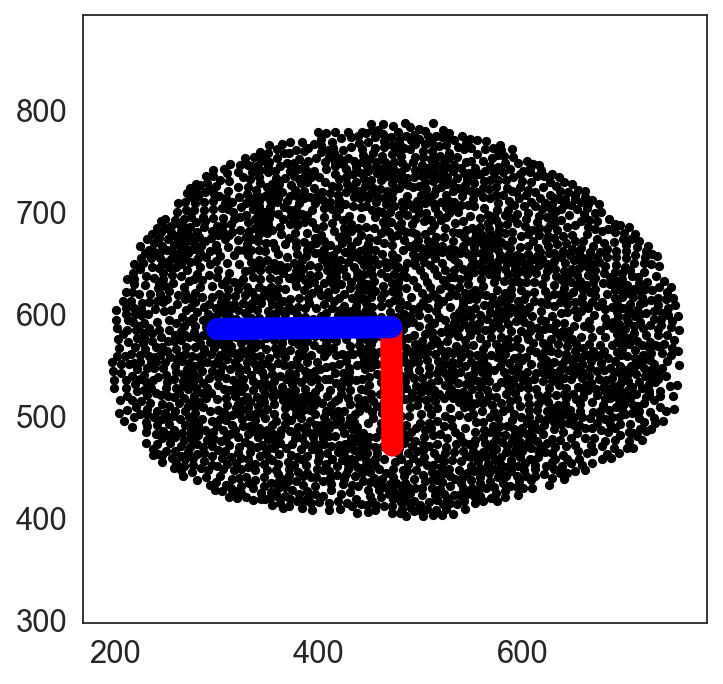

In [72]:
fig, ax = plt.subplots(figsize=(5,5))
ax.scatter(coords[:,1],coords[:,0], s=10, c='k')
ax.plot(x0, y0, '.g', markersize=15)
ax.plot((x0, x1), (y0, y1), '-r', linewidth=10)
ax.plot((x0, x2), (y0, y2), '-b', linewidth=10)
ax.axis('equal')